# Projeto 4 - DCGAN CIFAR-10

In [1]:
# Imports iniciais
import torch
import torch.nn as nn
import torch.optim as optim
import torch.utils.data as data
import torchvision.transforms as transforms
import torchvision.datasets as datasets
import torchvision.utils as vutils

import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML


# Configurações de hiperparâmetros e dispositivos
manualSeed = 999
print("Random Seed: ", manualSeed)
torch.manual_seed(manualSeed)
torch.use_deterministic_algorithms(True)

batch_size = 128
image_size = 32  # imagens de 32x32
nc = 3  # Número de canais (RGB)
nz = 100  # Dimensão do vetor latente
ngf = 64  # Tamanho dos mapas de features no gerador
ndf = 64  # Tamanho dos mapas de features no discriminador
num_epochs = 200
# lr = 0.0001
lr = 0.00005
beta1 = 0.5
ngpu = 1

device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
print("Configurações atualizadas com sucesso")


Random Seed:  999
Configurações atualizadas com sucesso


No CIFAR-10, as imagens são associadas a rótulos de 0 a 9, onde cada número representa uma classe:

0: Avião
1: Automóvel
2: Pássaro
3: Gato
4: Veado
5: Cachorro
6: Sapo
7: Cavalo
8: Navio
9: Caminhão

In [2]:
transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5))
])

training_data = datasets.CIFAR10(
    root="data",
    train=True,
    download=True,
    transform=transform
)
classes_desejadas = [7]
filtered_dataset = [
    (img, label) for img, label in training_data if label in classes_desejadas
]

dataloader = data.DataLoader(
    filtered_dataset,
    batch_size=batch_size,
    shuffle=True,
    num_workers=2
)

100%|██████████| 170498071/170498071 [00:03<00:00, 48968684.18it/s]


Extracting data/cifar-10-python.tar.gz to data


In [3]:
# Inicialização de pesos personalizada
def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)

In [4]:



# Redefina o Generator
class Generator(nn.Module):
    def __init__(self, ngpu):
        super(Generator, self).__init__()
        self.ngpu = ngpu
        self.main = nn.Sequential(
            # input is Z, going into a convolution
            nn.ConvTranspose2d( nz, ngf * 8, 4, 1, 0, bias=False),
            nn.BatchNorm2d(ngf * 8),
            nn.ReLU(True),
            # state size. (ngf*8) x 4 x 4
            nn.ConvTranspose2d(ngf * 8, ngf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 4),
            nn.ReLU(True),
            # state size. (ngf*4) x 8 x 8
            nn.ConvTranspose2d( ngf * 4, ngf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 2),
            nn.ReLU(True),
            # state size. (ngf*2) x 16 x 16
            nn.ConvTranspose2d( ngf * 2, nc, 4, 2, 1, bias=False),
            nn.Tanh()
            # state size. (nc) x 32 x 32
        )
    def forward(self, input):
        return self.main(input)

# Redefina o Discriminator
class Discriminator(nn.Module):
    def __init__(self, ngpu):
        super(Discriminator, self).__init__()
        self.ngpu = ngpu
        self.main = nn.Sequential(
            # input is (nc) x 32 x 32
            nn.Conv2d(nc, ndf, 4, 2, 1, bias=False),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf) x 16 x 16
            nn.Conv2d(ndf, ndf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 2),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf*2) x 8 x 8
            nn.Conv2d(ndf * 2, ndf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 4),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf*4) x 4 x 4
            nn.Conv2d(ndf * 4, 1, 4, 1, 0, bias=False),
            nn.Sigmoid()
        )
    def forward(self, input):
        return self.main(input)

# Criação das redes G e D
netG = Generator(ngpu).to(device)
netD = Discriminator(ngpu).to(device)

netG.apply(weights_init)
netD.apply(weights_init)

#BCELOSS
criterion = nn.BCELoss()
fixed_noise = torch.randn(64, nz, 1, 1, device=device)
real_label = 1
fake_label = 0

optimizerD = optim.Adam(netD.parameters(), lr=lr, betas=(beta1, 0.999))
optimizerG = optim.Adam(netG.parameters(), lr=lr, betas=(beta1, 0.999))

# Loop de treinamento (igual ao código original)
# Aqui você usará 'train_tensor' no DataLoader em vez de 'dataloader'
img_list = []
G_losses = []
D_losses = []
iters = 0


In [5]:

print("Iniciando o treinamento...")
for epoch in range(num_epochs):
    for i, data in enumerate(dataloader, 0):
        netD.zero_grad()
        real_cpu = data[0].to(device)
        b_size = real_cpu.size(0)
        label = torch.full((b_size,), real_label, dtype=torch.float, device=device)
        output = netD(real_cpu).view(-1)
        errD_real = criterion(output, label)
        errD_real.backward()
        D_x = output.mean().item()

        noise = torch.randn(b_size, nz, 1, 1, device=device)
        fake = netG(noise)
        label.fill_(fake_label)
        output = netD(fake.detach()).view(-1)
        errD_fake = criterion(output, label)
        errD_fake.backward()
        D_G_z1 = output.mean().item()
        errD = errD_real + errD_fake
        optimizerD.step()

        netG.zero_grad()
        label.fill_(real_label)
        output = netD(fake).view(-1)
        errG = criterion(output, label)
        errG.backward()
        D_G_z2 = output.mean().item()
        optimizerG.step()

        if i % 50 == 0:
            print('[%d/%d][%d/%d]\tLoss_D: %.4f\tLoss_G: %.4f\tD(x): %.4f\tD(G(z)): %.4f / %.4f'
                  % (epoch, num_epochs, i, len(dataloader),
                     errD.item(), errG.item(), D_x, D_G_z1, D_G_z2))

        G_losses.append(errG.item())
        D_losses.append(errD.item())

        if (iters % 500 == 0) or ((epoch == num_epochs-1) and (i == len(dataloader)-1)):
            with torch.no_grad():
                fake = netG(fixed_noise).detach().cpu()
            img_list.append(vutils.make_grid(fake, padding=2, normalize=True))

        iters += 1

Iniciando o treinamento...
[0/200][0/40]	Loss_D: 1.5759	Loss_G: 0.8354	D(x): 0.6235	D(G(z)): 0.6058 / 0.4683
[1/200][0/40]	Loss_D: 1.2028	Loss_G: 1.4246	D(x): 0.5958	D(G(z)): 0.4437 / 0.2592
[2/200][0/40]	Loss_D: 0.8358	Loss_G: 2.1359	D(x): 0.6730	D(G(z)): 0.2957 / 0.1320
[3/200][0/40]	Loss_D: 0.4643	Loss_G: 2.5877	D(x): 0.8129	D(G(z)): 0.2048 / 0.0831
[4/200][0/40]	Loss_D: 0.3889	Loss_G: 3.1074	D(x): 0.7962	D(G(z)): 0.1162 / 0.0507
[5/200][0/40]	Loss_D: 0.2195	Loss_G: 3.2634	D(x): 0.9094	D(G(z)): 0.0989 / 0.0450
[6/200][0/40]	Loss_D: 0.3251	Loss_G: 2.9826	D(x): 0.8428	D(G(z)): 0.1253 / 0.0586
[7/200][0/40]	Loss_D: 0.2353	Loss_G: 3.4515	D(x): 0.9084	D(G(z)): 0.1172 / 0.0356
[8/200][0/40]	Loss_D: 0.2464	Loss_G: 4.0070	D(x): 0.8754	D(G(z)): 0.0803 / 0.0208
[9/200][0/40]	Loss_D: 0.1695	Loss_G: 3.6915	D(x): 0.9460	D(G(z)): 0.1030 / 0.0289
[10/200][0/40]	Loss_D: 0.1236	Loss_G: 3.8815	D(x): 0.9434	D(G(z)): 0.0577 / 0.0226
[11/200][0/40]	Loss_D: 0.2524	Loss_G: 3.6635	D(x): 0.9281	D(G(z)): 0.1

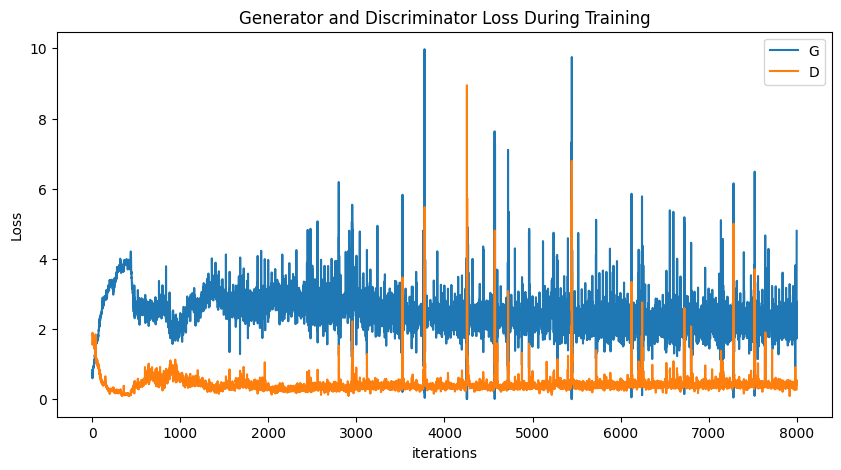

In [6]:
plt.figure(figsize=(10,5))
plt.title("Generator and Discriminator Loss During Training")
plt.plot(G_losses,label="G")
plt.plot(D_losses,label="D")
plt.xlabel("iterations")
plt.ylabel("Loss")
plt.legend()
plt.show()

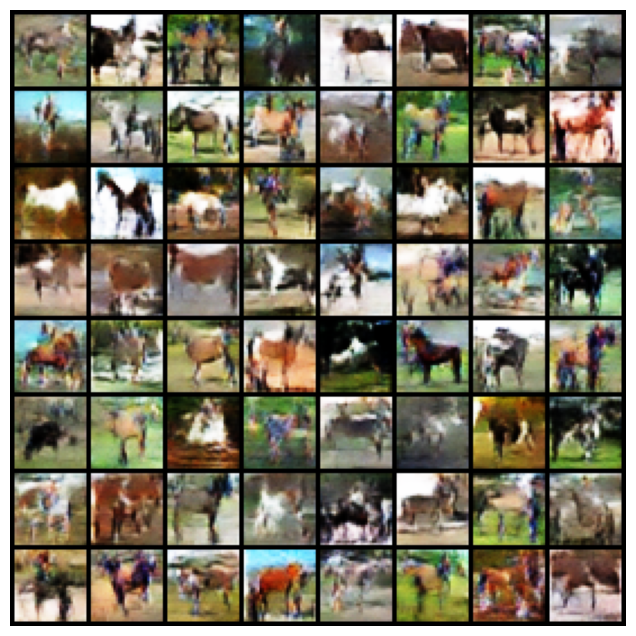

In [7]:
fig = plt.figure(figsize=(8,8))
plt.axis("off")
ims = [[plt.imshow(np.transpose(i,(1,2,0)), animated=True)] for i in img_list]
ani = animation.ArtistAnimation(fig, ims, interval=1000, repeat_delay=1000, blit=True)

HTML(ani.to_jshtml())

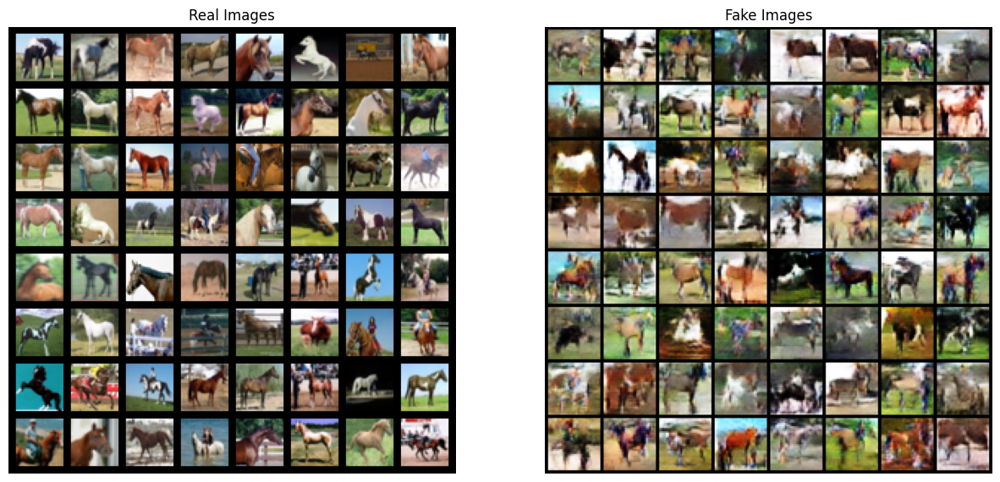

In [8]:
# Grab a batch of real images from the dataloader
real_batch = next(iter(dataloader))

# Plot the real images
plt.figure(figsize=(15,15))
plt.subplot(1,2,1)
plt.axis("off")
plt.title("Real Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=5, normalize=True).cpu(),(1,2,0)))

# Plot the fake images from the last epoch
plt.subplot(1,2,2)
plt.axis("off")
plt.title("Fake Images")
plt.imshow(np.transpose(img_list[-1],(1,2,0)))
plt.show()